# Collisions Graph - mapping collisions to road networks

__Last update: June 2022__

This notebook provides an alternative to the method analysed in `clustering-collisions.ipynb`. Instead of clustering collisions together, we want to map collisions back to existing open source data on junctions.

I've found two sources we could use to map out junctions across London.

### Option 1 - https://github.com/AndGem/OsmToRoadGraph

I pulled the data for this source using:
`python run.py -f data/greater-london-latest.osm -n c --networkx`

You can modify the configuration.py file to remove certain road types etc. and I've used the car option (`c`) since it's mostly junctions which cars can use we're interested in.

### Option 2 - https://github.com/gboeing/osmnx

This second source is from the same raw data (AFAIK). This package allows us to read in the data directly into a graph object, which makes it easier to process. Plus there are some functions for simplifying the road network which might be useful.

__IDEAS / NOTES:__

- Clean up function works, but it deosn't do anything to leave in more major connections - how could we adapt it? One way would be to remove nodes with low degree.

__TODO:__ clean up imports - don't think all are needed?

In [26]:
import json
import os
import geopandas
import pandas as pd
import seaborn as sns
import osmnx as ox
import contextily as cx
import matplotlib.pyplot as plt

# this prevents a lot of future warnings that are coming out of oxmnx
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from scipy import spatial
from ipyleaflet import basemaps, Marker, Map
from dotenv import load_dotenv
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN, AgglomerativeClustering, KMeans

load_dotenv()
os_api_key = os.getenv('OS_API_KEY')

%config InlineBackend.figure_format = 'retina'

sns.set_palette('Dark2')
plt.rcParams["font.family"] = "Calibri"
plt.rcParams["font.size"] = 12

In [2]:
def get_nearest_junction(row, tree):
    crash_coordinate = row[['latitude', 'longitude']].values
    result = tree.query(crash_coordinate)

    distance = result[0]
    junction_id = result[1]
    return distance, junction_id


# now done in pre-processing
# def weight_accident_severity(severity):
#     '''
#     Upweights more severe collisions for junction comparison.
#     '''
#     if severity == 'Fatal':
#         return 3
#     if severity == 'Serious':
#         return 1
#     else:
#         return 0

# 1. Read in collision data

`../data/london-crashes.csv` filter to serious and fatal collisions only.

In [3]:
# not a massive fan of the use of the term 'accidents'
collisions = pd.read_csv('../data/london-crashes.csv')

collisions.rename(columns={'accident_index': 'id'}, inplace=True)

collisions = collisions[
    (collisions['max_cyclist_severity'] != 'slight') &
    (collisions['junction_detail'] != 'Private drive or entrance')
]

# example rows
collisions.sample(5)

,id,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,...,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location,datetime,fatal_cyclist_casualties,serious_cyclist_casualties,slight_cyclist_casualties,danger_metric,recency_danger_metric,max_cyclist_severity
4255,201201HT20263,2012,01HT20263,536430.0,182510.0,-0.034775,51.524978,Metropolitan Police,Serious,2,...,Yes,Non-trunk,E01004232,2012-04-16T16:28:00Z,0,1,0,1,0.477121,serious
11842,201401VW40269,2014,01VW40269,526770.0,169730.0,-0.178526,51.412372,Metropolitan Police,Serious,1,...,Yes,Non-trunk,E01003408,2014-06-13T15:43:00Z,0,1,0,1,0.698970,serious
27831,2020010264187,2020,010264187,536772.0,169485.0,-0.034879,51.407903,Metropolitan Police,Serious,2,...,Yes,Non-trunk,E01000709,2020-08-26T16:40:00Z,0,1,0,1,1.041393,serious
18273,2017010022670,2017,010022670,526370.0,178460.0,-0.181153,51.490975,Metropolitan Police,Serious,2,...,Yes,Non-trunk,E01002837,2017-03-03T20:40:00Z,0,1,0,1,0.903090,serious
9758,201401EK40683,2014,01EK40683,530640.0,181250.0,-0.118656,51.515023,Metropolitan Police,Serious,1,...,Yes,Non-trunk,E01000914,2014-08-28T23:40:00Z,0,1,0,1,0.698970,serious


# 2. Load in option 1 junction graph

Stored in `../data/greater-london-latest.json`, which is from the output of this command: `python run.py -f data/greater-london-latest.osm -n c --networkx`

In [4]:
with open('../data/greater-london-latest.json') as f:
    d = json.load(f)

print(d.keys())

junctions_opt_1 = pd.DataFrame(d['nodes'])
junctions_opt_1.rename(
    columns={
        'lat': 'latitude',
        'lon': 'longitude',
        'id': 'junction_id'
    },
    inplace=True
)

del d

print(f'{len(junctions_opt_1)} junctions')
junctions_opt_1.sample(5)

dict_keys(['directed', 'multigraph', 'graph', 'nodes', 'adjacency'])
186846 junctions


,latitude,longitude,junction_id
168794,51.429281,-0.088140,168794
24684,51.578403,0.207951,24684
5655,51.454445,-0.318205,5655
117510,51.383044,-0.100043,117510
70041,51.422158,-0.379346,70041


# 3. Load in option 2 junction graph

Using `osmnx` package, which we can read in as a networkx graph object.

Simplify graph using the `consolidate_intersections` function.

See plot of simplified local example, before I pull full London network. It takes a while to process.

Nodes: 563


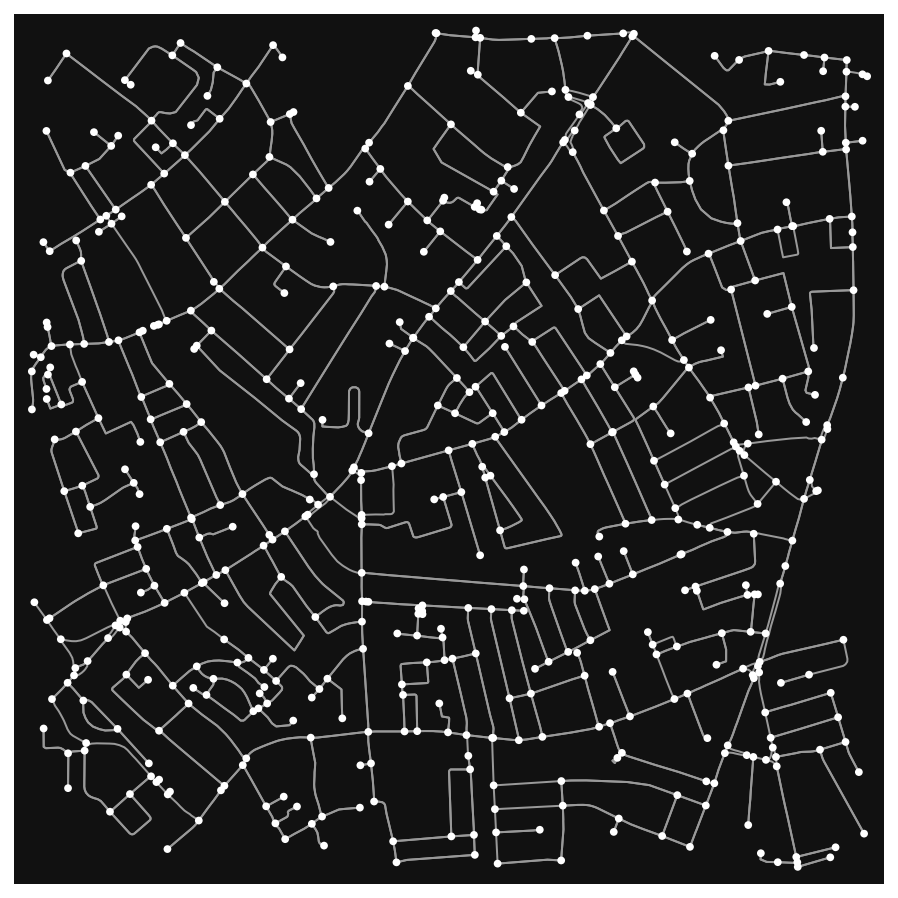

Nodes: 388


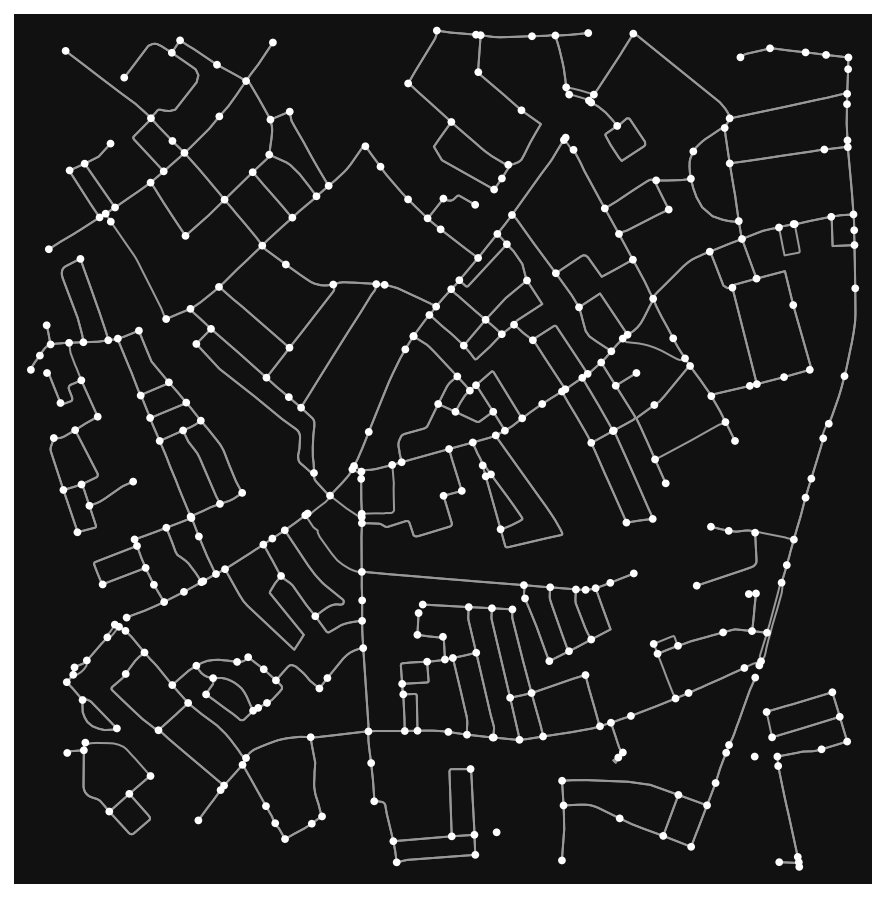

Nodes: 257


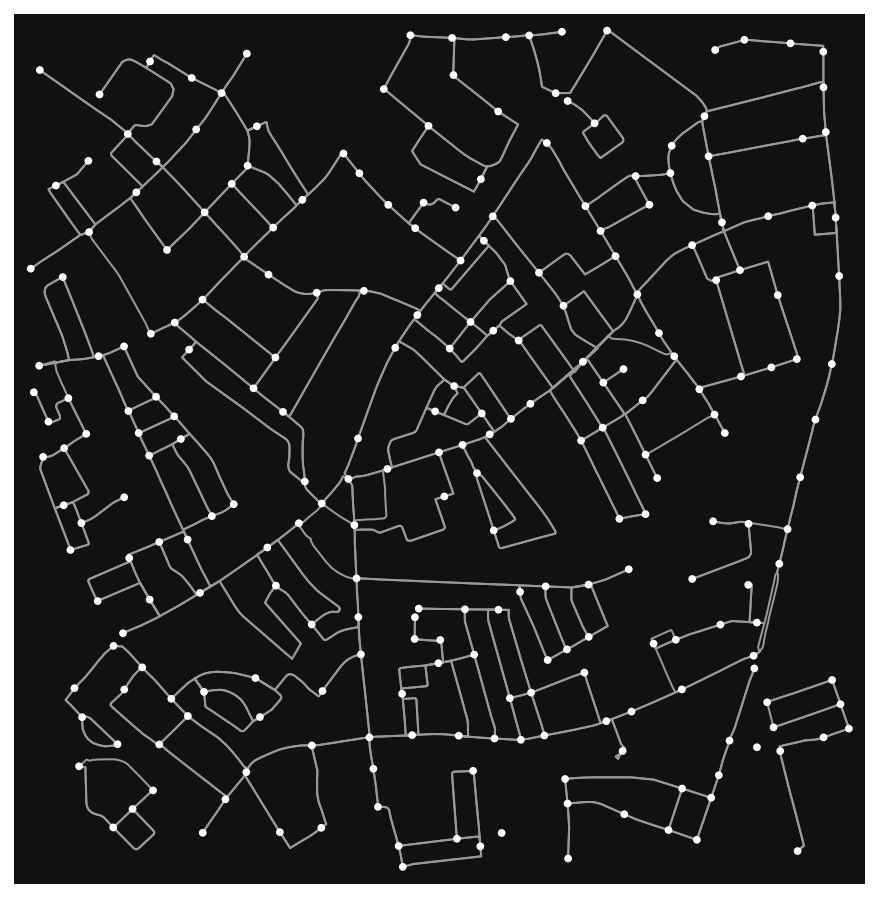

In [5]:
test_G = ox.graph_from_address('Landor Road, London, UK', network_type='drive')

print(f'Nodes: {len(test_G.nodes)}')
ox.plot_graph(test_G)

# Remove nodes with low degree

nodes_to_remove = [node for node,degree in dict(test_G.degree()).items() if degree <= 3]
test_G.remove_nodes_from(nodes_to_remove)

print(f'Nodes: {len(test_G.nodes)}')
ox.plot_graph(test_G);

test_G = ox.consolidate_intersections(
    ox.project_graph(test_G),
    tolerance=25,  # combines junctions within 25m
    rebuild_graph=True,
    dead_ends=False
)

print(f'Nodes: {len(test_G.nodes)}')
ox.plot_graph(test_G);

In [6]:
G = ox.graph_from_address(
    'London, UK',
    dist=15000,
    network_type='drive'
)
print(f'Nodes: {len(G.nodes)}')

# Remove nodes with low degree

nodes_to_remove = [node for node,degree in dict(G.degree()).items() if degree <= 2]
G.remove_nodes_from(nodes_to_remove)
print(f'Nodes: {len(G.nodes)}')

G = ox.consolidate_intersections(
    ox.project_graph(G),
    tolerance=35,
    rebuild_graph=True,
    dead_ends=False
)
print(f'Nodes: {len(G.nodes)}')

ids, lats, lons = [], [], []

n = 0
for node in G.nodes(data=True):
    try:
        lons.append(node[1]['lon'])
        lats.append(node[1]['lat'])
        ids.append(n)
        n += 1
    except:
        continue

junctions_opt_2 = pd.DataFrame({
    'latitude': lats,
    'longitude': lons,
    'junction_id': ids
})

junctions_opt_2

Nodes: 88208
Nodes: 67154
Nodes: 24923


,latitude,longitude,junction_id
0,51.535179,-0.148104,0
1,51.528960,-0.145843,1
2,51.537514,-0.152655,2
3,51.537330,-0.154627,3
4,51.534054,-0.162657,4
...,...,...,...
13940,51.499592,0.031538,13940
13941,51.560109,-0.280631,13941
13942,51.375017,-0.278856,13942
13943,51.395847,-0.020291,13943


## 3.1 Plot junctions map

See if simplification at right level...

`tolerance=50` was definitely too high, `tolerance=25` seems like okay compromise. Also dependent on the initial `dist` parameter, since that sets the initital number of nodes.

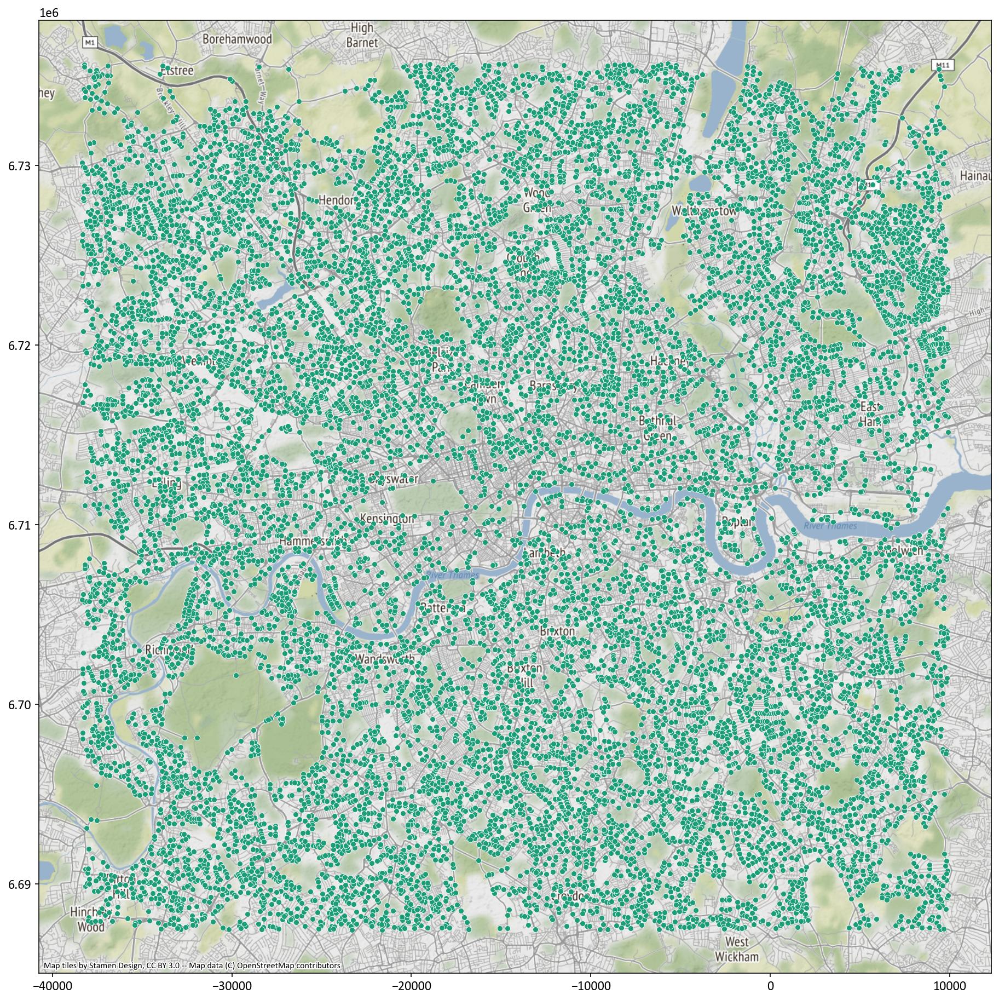

In [7]:
gpd_junctions_opt_2 = geopandas.GeoDataFrame(
    junctions_opt_2,
    geometry=geopandas.points_from_xy(junctions_opt_2.longitude, junctions_opt_2.latitude, crs="EPSG:4326")
)

gpd_junctions_opt_2.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_junctions_opt_2.geometry.x,
    y=gpd_junctions_opt_2.geometry.y,
    alpha=1,
    s=25
);

cx.add_basemap(ax)

# Clustering Junctions

To limit the number - the above is too much?

Should we scale?

In [50]:
scaler = StandardScaler()

X = junctions_opt_2[['latitude', 'longitude']]
X = scaler.fit_transform(X)

clustering = KMeans(n_clusters=5000).fit(X)
# clustering = DBSCAN(eps=.01, min_samples=3).fit(X)
# clustering = AgglomerativeClustering(n_clusters=5000).fit(X)

junctions_opt_2['cluster'] = clustering.labels_.astype(str)

In [51]:
plt_data = junctions_opt_2[
    (junctions_opt_2['latitude'] >= 51.45) &
    (junctions_opt_2['latitude'] <= 51.5) &
    (junctions_opt_2['longitude'] >= -.12) &
    (junctions_opt_2['longitude'] <= -.11) 
]

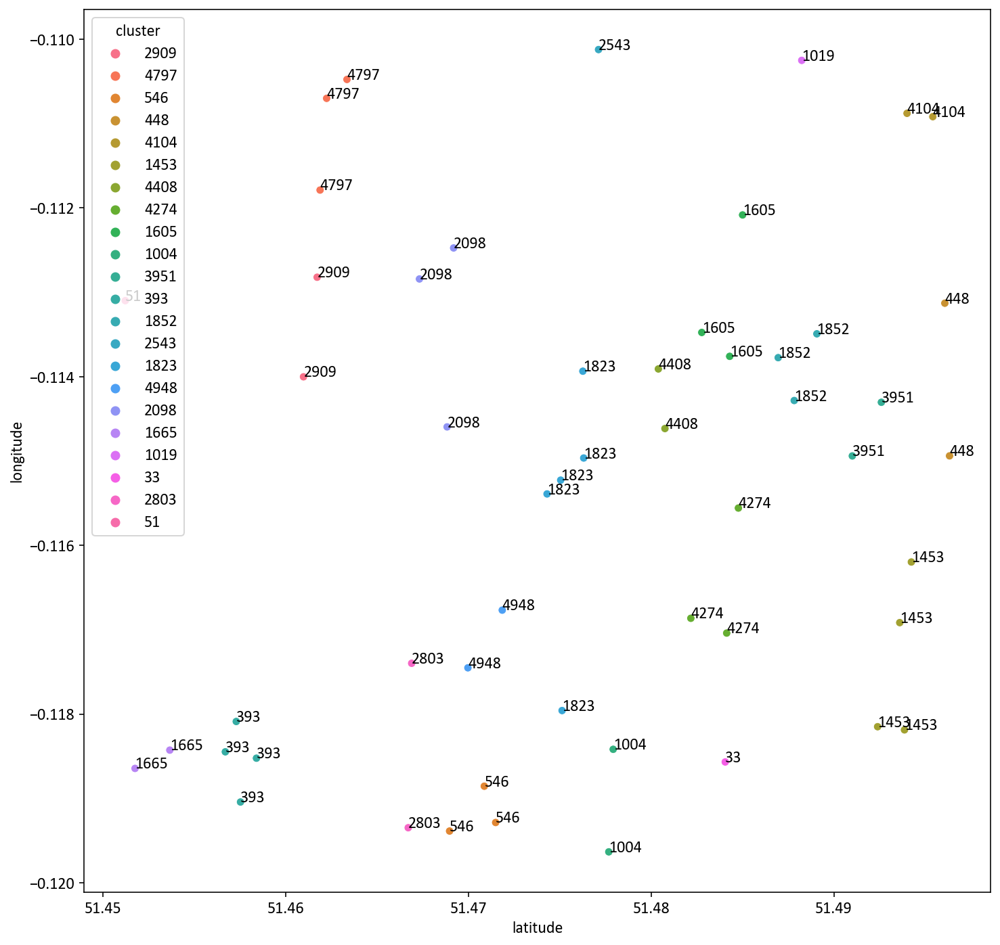

In [52]:
plt.figure(figsize=(12, 12))
sns.scatterplot(
    data=plt_data,
    x='latitude',
    y='longitude',
    hue='cluster'
);

def label_point(x, y, val, ax):
    a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x'], point['y'], str(point['val']))

label_point(plt_data.latitude, plt_data.longitude, plt_data.cluster, plt.gca())

# 4. Assign collisions to junctions

Now we have two junction graphs we want to assign collisions to a junction based on the closest one.

https://en.wikipedia.org/wiki/K-d_tree

In [8]:
# create k-d trees..
tree_opt_1 = spatial.KDTree(junctions_opt_1[['latitude', 'longitude']])
tree_opt_2 = spatial.KDTree(junctions_opt_2[['latitude', 'longitude']])

collisions[['distance_opt_1', 'junction_id_opt_1']] = collisions.apply(
    lambda row: get_nearest_junction(row, tree_opt_1), axis=1, result_type='expand'
)
collisions[['distance_opt_2', 'junction_id_opt_2']] = collisions.apply(
    lambda row: get_nearest_junction(row, tree_opt_2), axis=1, result_type='expand'
)

collisions.sample(5)

,id,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,...,fatal_cyclist_casualties,serious_cyclist_casualties,slight_cyclist_casualties,danger_metric,recency_danger_metric,max_cyclist_severity,distance_opt_1,junction_id_opt_1,distance_opt_2,junction_id_opt_2
43508,2018010123578,2018,010123578,532560.0,178960.0,-0.091856,51.494052,Metropolitan Police,Serious,2,...,0,1,0,1,1.301030,serious,0.000083,44810.0,0.002615,8613.0
42761,2018010107142,2018,010107142,527490.0,176440.0,-0.165758,51.472570,Metropolitan Police,Serious,2,...,0,1,0,1,1.301030,serious,0.000153,25868.0,0.002985,7216.0
45120,2019010166370,2019,010166370,530062.0,181440.0,-0.126905,51.516919,Metropolitan Police,Serious,2,...,0,1,0,1,1.322219,serious,0.000015,476.0,0.003658,124.0
29252,201301MM70402,2013,01MM70402,532400.0,178070.0,-0.094498,51.486036,Metropolitan Police,Serious,1,...,0,1,0,1,1.176091,serious,0.000127,10225.0,0.001380,6782.0
12663,200701CP00121,2007,01CP00121,533830.0,180900.0,-0.072842,51.511131,City of London,Serious,2,...,0,1,0,1,0.954243,serious,0.000021,101910.0,0.001043,13821.0


# 5. Join data to nearest junction and summarise

Do we need a maximum distance filter?

Maximum distance filter needed for opt 2 as the network doesn't extend out far enough relative to the collision data yet.

,junction_id,latitude_junction,longitude_junction,recency_danger_metric
3811,137032,51.514036,-0.104365,11.529210
4888,178978,51.510935,-0.066970,9.897999
411,6500,51.497070,-0.099305,7.931344
1347,32942,51.473376,-0.071138,7.483099
332,4776,51.506223,-0.209100,7.227683
2624,93673,51.513303,-0.089026,7.217686
2694,96795,51.518901,-0.121263,7.050457
3047,106938,51.472951,0.003266,6.982423
2193,72056,51.529522,-0.013671,6.870104
2658,95542,51.522166,-0.201579,6.624922


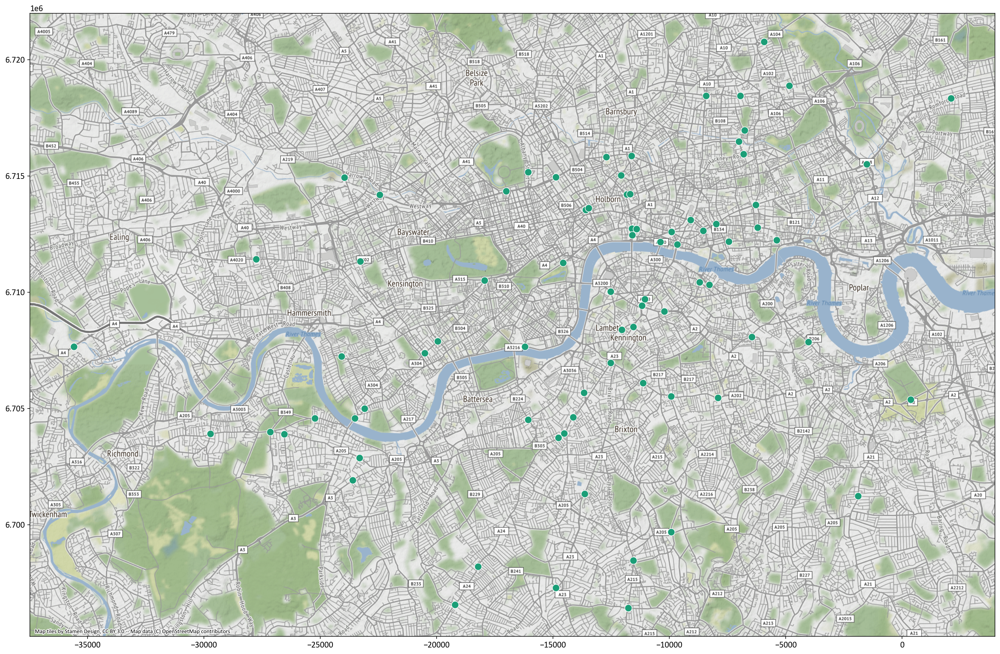

In [9]:
n = 80

junctions_stats_opt_1 = (
    collisions
    .merge(junctions_opt_1, how='left', left_on='junction_id_opt_1', right_on='junction_id')
    .groupby(['junction_id', 'latitude_y', 'longitude_y'])['recency_danger_metric']
    .sum()
    .reset_index()
    .rename(columns={'latitude_y': 'latitude_junction', 'longitude_y': 'longitude_junction'})
    .sort_values(by='recency_danger_metric', ascending=False)
    .head(n)
)

display(junctions_stats_opt_1.head(10))

gpd_junctions_stats_opt_1 = geopandas.GeoDataFrame(
    junctions_stats_opt_1,
    geometry=geopandas.points_from_xy(
        junctions_stats_opt_1.longitude_junction,
        junctions_stats_opt_1.latitude_junction,
        crs="EPSG:4326"
    )
)

gpd_junctions_stats_opt_1.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_junctions_stats_opt_1.geometry.x,
    y=gpd_junctions_stats_opt_1.geometry.y,
    alpha=1,
    s=100
);

cx.add_basemap(ax)

del gpd_junctions_stats_opt_1

## 5.1 Plot distances distribution for option 2

To help decide cut off value, set to `< .002`

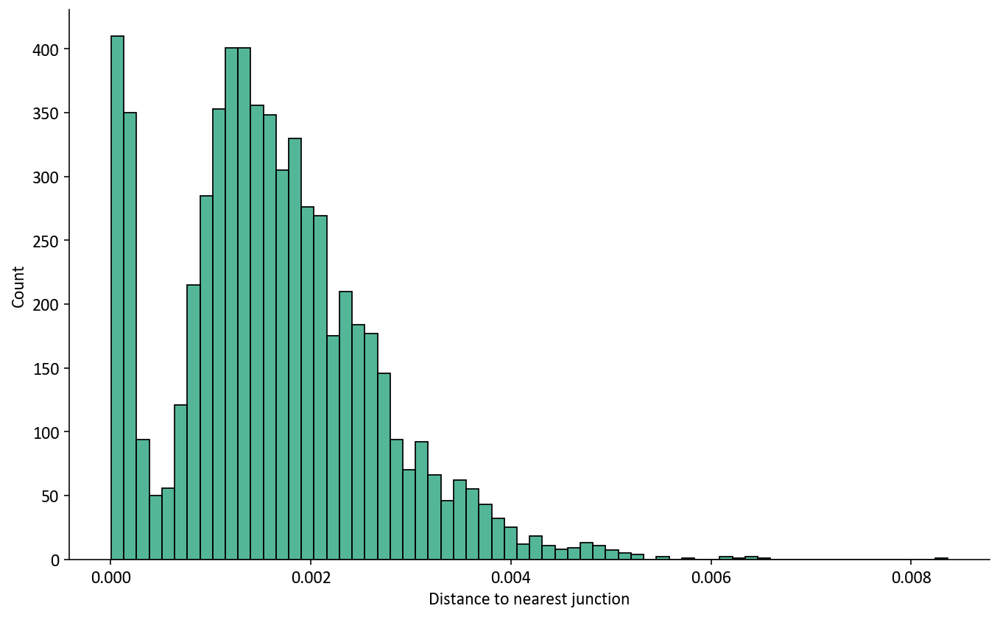

In [10]:
sns.displot(
    collisions.distance_opt_2,
    height=6,
    aspect=1.6
)
plt.xlabel('Distance to nearest junction');

,junction_id,latitude_junction,longitude_junction,recency_danger_metric
870,4278,51.515278,-0.104568,26.489971
148,271,51.522663,-0.078999,23.022564
1197,7404,51.432380,-0.165630,21.678999
1213,7594,51.515666,-0.073403,21.210881
1126,6781,51.495066,-0.099338,19.431981
603,2648,51.482773,-0.113476,18.457075
91,159,51.496068,-0.125416,16.474464
52,90,51.535650,-0.062314,15.948369
1841,13821,51.510092,-0.072935,14.921128
596,2639,51.513905,-0.087281,14.708568


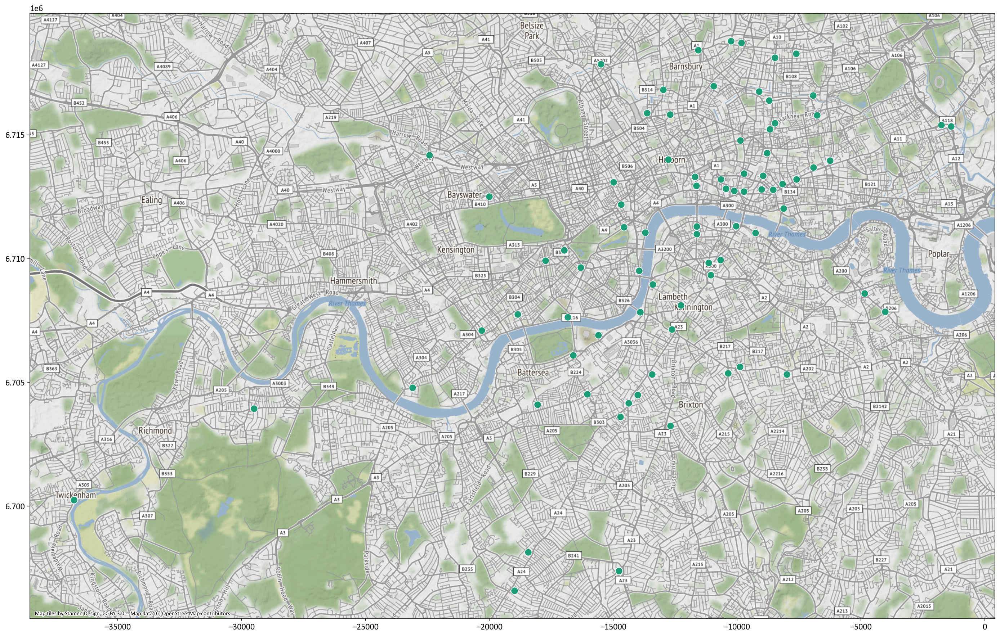

In [11]:
n = 80

junctions_stats_opt_2 = (
    collisions
    [collisions.distance_opt_2 < .002]
    .merge(junctions_opt_2, how='left', left_on='junction_id_opt_2', right_on='junction_id')
    .groupby(['junction_id', 'latitude_y', 'longitude_y'])['recency_danger_metric']
    .sum()
    .reset_index()
    .rename(columns={'latitude_y': 'latitude_junction', 'longitude_y': 'longitude_junction'})
    .sort_values(by='recency_danger_metric', ascending=False)
    .head(n)
)

display(junctions_stats_opt_2.head(10))

gpd_junctions_stats_opt_2 = geopandas.GeoDataFrame(
    junctions_stats_opt_2,
    geometry=geopandas.points_from_xy(
        junctions_stats_opt_2.longitude_junction,
        junctions_stats_opt_2.latitude_junction,
        crs="EPSG:4326"
    )
)

gpd_junctions_stats_opt_2.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_junctions_stats_opt_2.geometry.x,
    y=gpd_junctions_stats_opt_2.geometry.y,
    alpha=1,
    s=100
);

cx.add_basemap(ax)

del gpd_junctions_stats_opt_2

# Traffic volume data

Not quite sure how to combine this in yet.

,latitude,longitude,all_motor_vehicles,geometry
539,51.505982,-0.135910,50223,POINT (-15129.384 6711288.868)
191,51.478019,-0.129417,58331,POINT (-14406.674 6706289.338)
946,51.528839,-0.127335,148746,POINT (-14174.880 6715377.772)
181,51.476129,-0.095654,31651,POINT (-10648.133 6705951.468)
682,51.514835,-0.129870,148891,POINT (-14457.020 6712872.292)


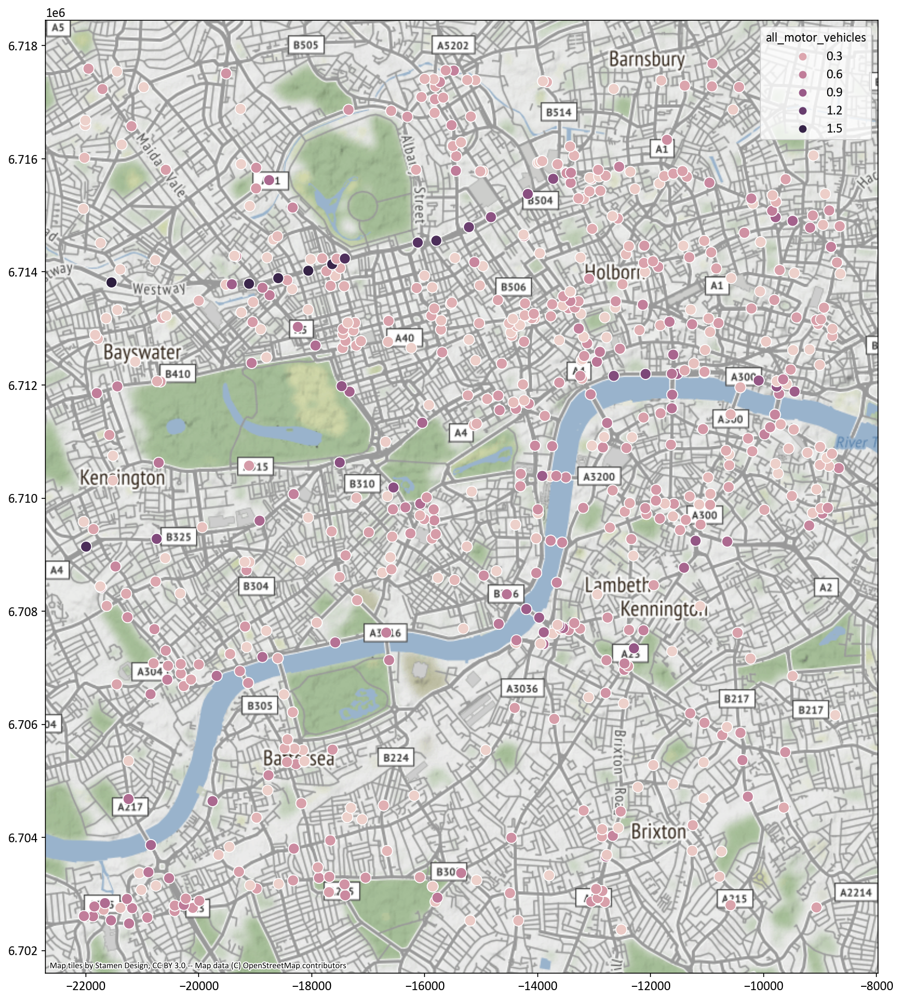

In [12]:
raw_volumes = pd.read_csv('../data/dft_aadfbydirection_region_id_6.csv')

# filter to London area
# 51.455953, 51.541914
# -.198716, -.077560

raw_volumes = raw_volumes[
    (raw_volumes['longitude'] >= -.198716) &
    (raw_volumes['longitude'] <= -.077560) &
    (raw_volumes['latitude'] >= 51.455953) &
    (raw_volumes['latitude'] <= 51.541914)
]

volumes = (
    raw_volumes
    .groupby([
        'latitude',
        'longitude'
#         , 'direction_of_travel'
    ])['all_motor_vehicles']
    .sum()
    .reset_index()
)

del raw_volumes

gpd_volumes = geopandas.GeoDataFrame(
    volumes,
    geometry=geopandas.points_from_xy(
        volumes.longitude,
        volumes.latitude,
        crs="EPSG:4326"
    )
)

gpd_volumes.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_volumes.geometry.x,
    y=gpd_volumes.geometry.y,
    hue=gpd_volumes.all_motor_vehicles,
    alpha=1,
    s=100
);

cx.add_basemap(ax)

del gpd_volumes

volumes.sample(5)